# Visualizing 2d data

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns 


In [2]:
df = pd.read_csv("P87-Section-3-Visual-Exploration-Resources\\P87-S3-Visual-Exploration-Resources\\meteorite-landings.csv")
df.head(2)

,name,id,nametype,recclass,mass,fall,year,reclat,reclong,GeoLocation
0,Aachen,1,Valid,L5,21.0,Fell,1880.0,50.77500,6.08333,"(50.775000, 6.083330)"
1,Aarhus,2,Valid,H6,720.0,Fell,1951.0,56.18333,10.23333,"(56.183330, 10.233330)"


In [3]:
df.dropna(subset=["reclong", "reclat"])
df=df[df["reclong"] < 300]

## 2d histograms

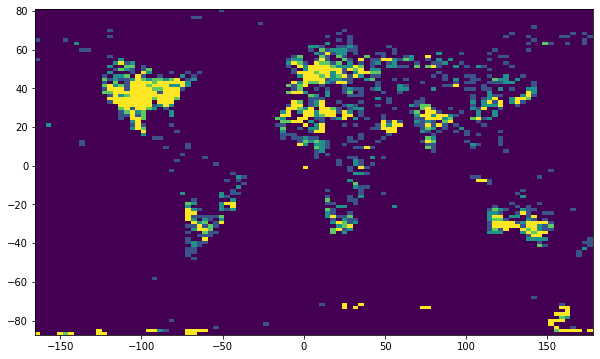

In [4]:
fig, ax = plt.subplots(figsize = (10, 6))

ax.hist2d(df["reclong"], df["reclat"], bins = 100, vmax = 4);

## 2d hex plots

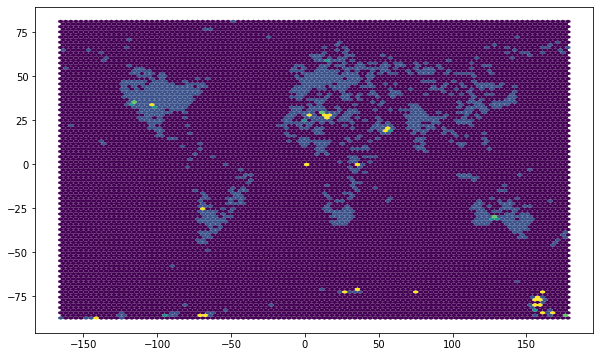

In [5]:
fig, ax = plt.subplots(figsize = (10, 6))

ax.hexbin(df["reclong"], df["reclat"], bins = 100, vmax = 4, lw = 0.0);

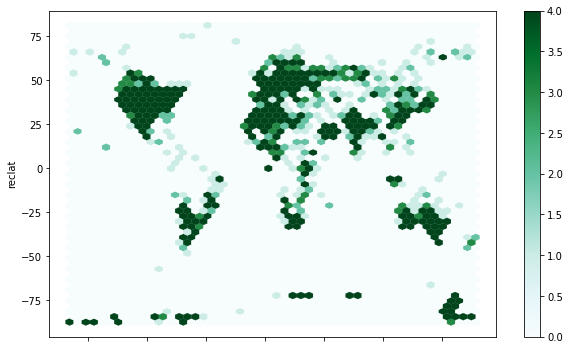

In [6]:
# pandas way

df.plot.hexbin(x = "reclong", y = "reclat", vmax = 4, gridsize = 50, linewidth = 0.25, figsize = (10, 6));

## 2d contour plots

In [7]:
spacing  = np.linspace(0, 10, 100)
X, Y =  np.meshgrid(spacing, spacing)

#create Z as a function of X and Y
Z =  (np.sin(X) + np.cos(Y) + 2* np.arcsinh(X*Y))**2

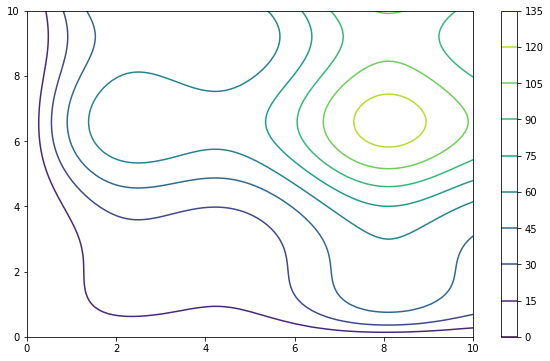

In [8]:
fig, ax = plt.subplots(figsize = (10, 6))

plt.contour(X, Y, Z, levels = 10)
plt.colorbar();

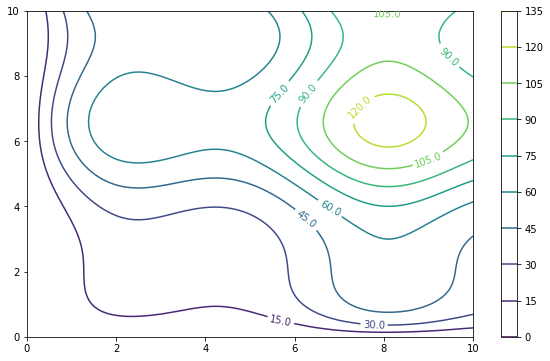

In [9]:
fig, ax = plt.subplots(figsize = (10, 6))

c = plt.contour(X, Y, Z, levels = 10);
plt.clabel(c, inline=True, fmt="%0.1f");
plt.colorbar();

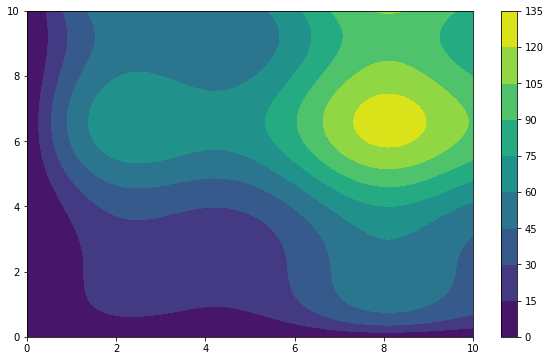

In [10]:
fig, ax = plt.subplots(figsize = (10, 6))

c = plt.contourf(X, Y, Z, levels = 10);
plt.colorbar();

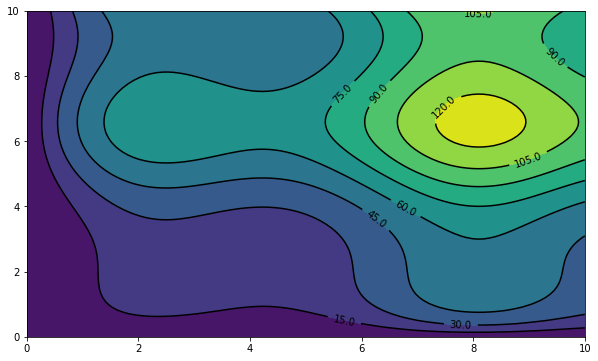

In [11]:
fig, ax = plt.subplots(figsize = (10, 6))

plt.contourf(X, Y, Z, levels = 10);
c = plt.contour(X, Y, Z, levels = 10, colors = "black")
plt.clabel(c, inline = True, fmt = "%0.1f");

## Kernel Density Estimation (KDE)

### Take an example of a random sample drawn from a function

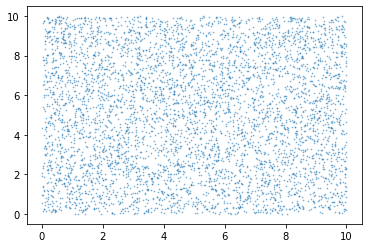

In [12]:
# This is called brute force sampling, a way to brute force sample any surface

n = 5000

xs, ys = np.random.uniform(0, 10, n), np.random.uniform(0, 10, n)

plt.scatter(xs, ys, s = 0.5, alpha = 0.5);

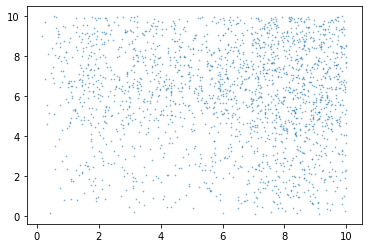

In [13]:

# from the above uniform scatter plot, sample the data that meet the fucntion criterion

zs = (np.sin(xs) + np.cos(ys) + 2*np.arcsinh(xs*ys))**2
zs /= zs.max()

passed = np.random.uniform(0, 1, n) < zs
xs, ys = xs[passed], ys[passed]

plt.scatter(xs, ys, s = 0.5, alpha = 0.5);

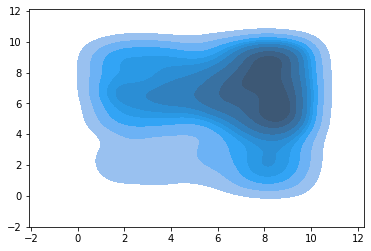

In [14]:
#the above sampled distribution can be replicated using kde plos in seaborn as below

sns.kdeplot(xs, ys, shade = "fill");

## joint plot

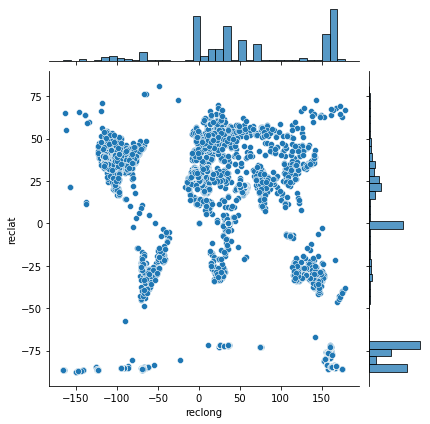

In [15]:
sns.jointplot(data = df, x = "reclong", y = "reclat");

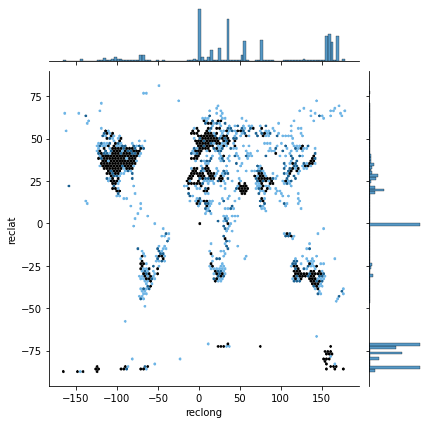

In [16]:
sns.jointplot(data = df, x = "reclong", y = "reclat", 
                kind = "hex", gridsize = 100, vmax = 3, linewidth = 0, 
                marginal_kws = {"bins":100});

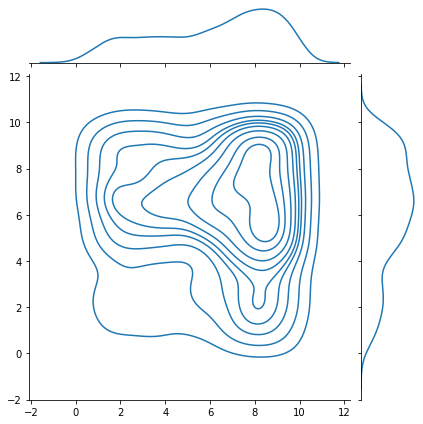

In [17]:
sns.jointplot(x = xs, y = ys, kind = "kde");

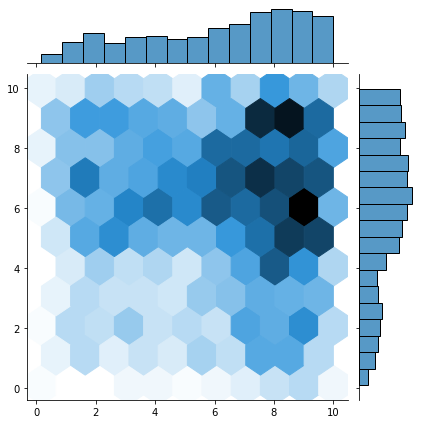

In [18]:
sns.jointplot(x = xs, y = ys, kind = "hex", gridsize = 10);

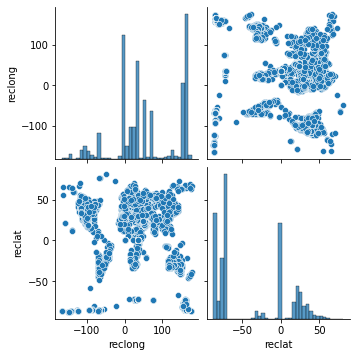

In [19]:
sns.pairplot(data = df[["reclong", "reclat"]]);